# Working with spherical harmonics
20/09/22

This notebook gives a brief introduction to some of the conventions and functionality for handling spherical harmonics and related functions, using low-level ePSproc routines. Note some higher-level routines are available in the [base class](../demos/ePSproc_class_demo_161020.html).

## Expansions in complex spherical harmonics 

In general, expansions in complex harmonics are used, with expansion parameters $\beta_{L,M}$. A given function is then written as:

\begin{equation}
I(\theta,\phi)=\sum_{l,m}\beta_{l,m}Y_{l,m}(\theta,\phi)\label{eq:sph-harmonics}
\end{equation}

The default routines in ePSproc [make use of scipy.special.sph_harm](https://docs.scipy.org/doc/scipy/reference/generated/scipy.special.sph_harm.html) as the default calculation routine. Note the $(\theta, \phi)$ definition, and normalisation, corresponding to the usual "physics" convention ($\theta$ defined from the z-axis, includes the Condon-Shortley phase, and orthonormalised):

\begin{equation}
Y_{l,m}(\theta,\phi) = (-1)^m\sqrt{\frac{2l+1}{4\pi} \frac{(l-m)!}{(l+m)!}}e^{i m \phi} P^m_l(\cos(\theta))
\end{equation}


For more details, see [also Wikipaedia, which has matching defintions plus further discussion](https://en.wikipedia.org/wiki/Spherical_harmonics). Note that in the Scipy routines the Condon-Shortley phase term, $(-1)^m$, is actually included in the associated Legendre polynomial function $P^m_l$, but is written explicitly above.

For additional control and conversion, the [SHtools library can also be used](https://shtools.github.io/SHTOOLS/complex-spherical-harmonics.html) - this includes some useful utility functions including converting between different forms (e.g. real and complex forms), and basic plotters.

## Expansions in symmetrized harmonics

In some case, symmetrized or generalised harmonics are useful. These are defined similarly, but with expansion coeffs additionally set by (point group) symmetry. A [basic implementation can be found in the PEMtk package](https://pemtk.readthedocs.io/en/latest/sym/pemtk_symHarm_demo_160322_tidy.html), defined as:

\begin{equation}
X_{hl}^{\Gamma\mu*}(\theta,\phi)=\sum_{\lambda}b_{hl\lambda}^{\Gamma\mu}Y_{l,\lambda}(\theta,\phi)\label{eq:symm-harmonics}
\end{equation}

Where the $b_{hl\lambda}^{\Gamma\mu}$ are defined by symmetry. General function expansions can then be written as a set of spherical harmonics including symmetrization, or an equivalent expansion in symmetrized harmonics (here not all indices may be necessary):

\begin{equation}
I(\theta,\phi)=\sum_{h,l,\Gamma,\mu}\beta_{hl}^{\Gamma\mu}X_{hl}^{\Gamma\mu*}(\theta,\phi)=\sum_{h,l,\Gamma,\mu}\sum_{\lambda}b_{hl\lambda}^{\Gamma\mu}\beta_{l,\lambda}Y_{l,\lambda}(\theta,\phi)\label{eq:symm-harmonics-2}
\end{equation}

## Expansions in Legendre polynomials

For cylindrically-symmetric cases ($m=0$), general expansions in Legendre polynomials are also sufficient and often used:

\begin{equation}
I(\theta)=\sum_{l}\beta_{l}P^0_l(\cos(\theta))\label{eq:lg-expansion}
\end{equation}

Where the "Legendre" and "spherical harmonic" expansion parameters for the harmonics defined above can be related by:

\begin{equation}
\beta^{Sph}_{l,0} = \sqrt{(2L+1)/4\pi}\beta^{Lg}_{l}
\end{equation}

## Numerical implementation

### Imports

OMP: Info #273: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


* sparse not found, sparse matrix forms not available. 
* natsort not found, some sorting functions not available. 
* Hvplot not found, some hvPlotters may not be available. See https://hvplot.holoviz.org/user_guide/Gridded_Data.html for package details.
* Setting plotter defaults with epsproc.basicPlotters.setPlotters(). Run directly to modify, or change options in local env.


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
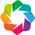

* Set Holoviews with bokeh.
* pyevtk not found, VTK export not available. 


In [1]:
import xarray as xr
import pandas as pd
import numpy as np
import epsproc as ep

### Computing spherical harmonics on a grid

A basic wrapper for the backends is provided by `ep.sphCalc`. This computes spherical harmonics for all orders up to `Lmax`, for a given angular resolution or set of angles, and returns an Xarray.


In [2]:
# Compute harmonics for 50x50 (theta,phi) grid
Isph = ep.sphCalc(Lmax = 2, res = 50)
Isph

<xarray.DataArray 'YLM' (LM: 9, Phi: 50, Theta: 50)>
array([[[ 0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j, ...,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j],
        [ 0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j, ...,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j],
        [ 0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j, ...,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j],
        ...,
        [ 0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j, ...,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j],
        [ 0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j, ...,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j],
        [ 0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j, ...,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j]],

...

       [[ 0.        +0.00000000e+00j,  0.00158565+0.00000000e+00j,
          0.00631658+0.00000000e+00j, ...,  0.00631658+0.00000000e+00j,
          0.00158565+0.00000000e+00j,  0.        +0.00000000e+00j],
        [ 0.        +0.00000000e+00j,  0.00153379+4.02208134e-04j,
          0.00610999+1.60222829e-03j, ...,  0.00610999+1.60222829e-03j,
          0.00153379+4.02208134e-04j,  0.        +0.00000000e+00j],
        [ 0.        +0.00000000e+00j,  0.00138161+7.78107724e-04j,
          0.00550375+3.09965439e-03j, ...,  0.00550375+3.09965439e-03j,
          0.00138161+7.78107724e-04j,  0.        +0.00000000e+00j],
        ...,
        [ 0.        +0.00000000e+00j,  0.00138161-7.78107724e-04j,
          0.00550375-3.09965439e-03j, ...,  0.00550375-3.09965439e-03j,
          0.00138161-7.78107724e-04j,  0.        +0.00000000e+00j],
        [ 0.        +0.00000000e+00j,  0.00153379-4.02208134e-04j,
          0.00610999-1.60222829e-03j, ...,  0.00610999-1.60222829e-03j,
          0.00153379-4.02208134e-04j,  0.        +0.00000000e+00j],
        [ 0.        +0.00000000e+00j,  0.00158565-7.76745914e-19j,
          0.00631658-3.09422951e-18j, ...,  0.00631658-3.09422951e-18j,
          0.00158565-7.76745914e-19j,  0.        +0.00000000e+00j]]])
Coordinates:
  * LM       (LM) MultiIndex
  - l        (LM) int64 0 1 1 1 2 2 2 2 2
  - m        (LM) int64 0 -1 0 1 -2 -1 0 1 2
  * Phi      (Phi) float64 0.0 0.1282 0.2565 0.3847 ... 5.899 6.027 6.155 6.283
  * Theta    (Theta) float64 0.0 0.06411 0.1282 0.1923 ... 3.013 3.077 3.142
Attributes:
    dataType:   YLM
    long_name:  Spherical harmonics
    harmonics:  {'dtype': 'Complex harmonics', 'kind': 'complex', 'normType':...
    units:      arb

In [3]:
# Compute harmonics for 50x25 (theta,phi) grid
I = ep.sphCalc(Lmax = 2, res = [50,25])
I

<xarray.DataArray 'YLM' (LM: 9, Phi: 25, Theta: 50)>
array([[[ 0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j, ...,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j],
        [ 0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j, ...,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j],
        [ 0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j, ...,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j],
        ...,
        [ 0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j, ...,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j],
        [ 0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j, ...,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j],
        [ 0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j, ...,  0.28209479+0.00000000e+00j,
          0.28209479+0.00000000e+00j,  0.28209479+0.00000000e+00j]],

...

       [[ 0.        +0.00000000e+00j,  0.00158565+0.00000000e+00j,
          0.00631658+0.00000000e+00j, ...,  0.00631658+0.00000000e+00j,
          0.00158565+0.00000000e+00j,  0.        +0.00000000e+00j],
        [ 0.        +0.00000000e+00j,  0.00137322+7.92826465e-04j,
          0.00547031+3.15828767e-03j, ...,  0.00547031+3.15828767e-03j,
          0.00137322+7.92826465e-04j,  0.        +0.00000000e+00j],
        [ 0.        +0.00000000e+00j,  0.00079283+1.37321572e-03j,
          0.00315829+5.47031471e-03j, ...,  0.00315829+5.47031471e-03j,
          0.00079283+1.37321572e-03j,  0.        +0.00000000e+00j],
        ...,
        [ 0.        +0.00000000e+00j,  0.00079283-1.37321572e-03j,
          0.00315829-5.47031471e-03j, ...,  0.00315829-5.47031471e-03j,
          0.00079283-1.37321572e-03j,  0.        +0.00000000e+00j],
        [ 0.        +0.00000000e+00j,  0.00137322-7.92826465e-04j,
          0.00547031-3.15828767e-03j, ...,  0.00547031-3.15828767e-03j,
          0.00137322-7.92826465e-04j,  0.        +0.00000000e+00j],
        [ 0.        +0.00000000e+00j,  0.00158565-7.76745914e-19j,
          0.00631658-3.09422951e-18j, ...,  0.00631658-3.09422951e-18j,
          0.00158565-7.76745914e-19j,  0.        +0.00000000e+00j]]])
Coordinates:
  * LM       (LM) MultiIndex
  - l        (LM) int64 0 1 1 1 2 2 2 2 2
  - m        (LM) int64 0 -1 0 1 -2 -1 0 1 2
  * Phi      (Phi) float64 0.0 0.2618 0.5236 0.7854 ... 5.498 5.76 6.021 6.283
  * Theta    (Theta) float64 0.0 0.06411 0.1282 0.1923 ... 3.013 3.077 3.142
Attributes:
    dataType:   YLM
    long_name:  Spherical harmonics
    harmonics:  {'dtype': 'Complex harmonics', 'kind': 'complex', 'normType':...
    units:      arb

Sph plots: 
Plotting with facetDims=Eke, pType=a with backend=mpl.


[<Figure size 720x480 with 1 Axes>]

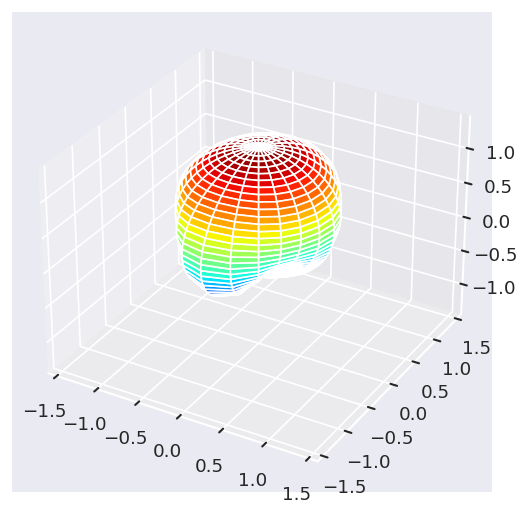

In [4]:
# These can be plotted ... although may not be very useful
ep.sphSumPlotX(I)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
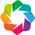

* Set Holoviews with bokeh.


In [5]:
# Change plot style to default MPL
ep.basicPlotters.setPlotters(resetMpl=True)

Sph plots: 
Plotting with facetDims=Eke, pType=a with backend=mpl.


[<Figure size 640x480 with 1 Axes>]

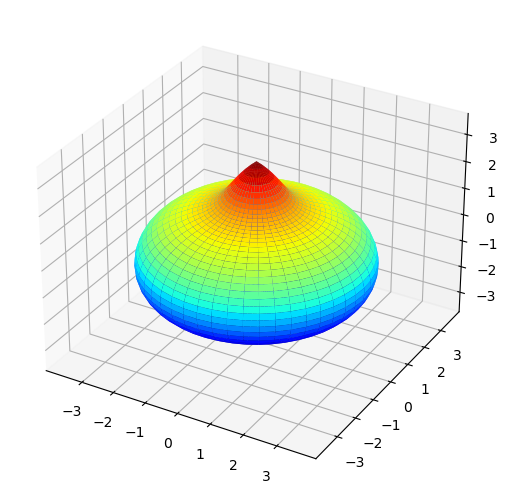

In [6]:
# For Legendre Polynomials, set fnType = 'lg'
Ilg = ep.sphCalc(Lmax = 2, res = 50, fnType = 'lg')
ep.sphSumPlotX(Ilg)

In [7]:
Ilg

<xarray.DataArray 'PL' (LM: 9, Phi: 50, Theta: 50)>
array([[[ 1.        ,  1.        ,  1.        , ...,  1.        ,
          1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        , ...,  1.        ,
          1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        , ...,  1.        ,
          1.        ,  1.        ],
        ...,
        [ 1.        ,  1.        ,  1.        , ...,  1.        ,
          1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        , ...,  1.        ,
          1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        , ...,  1.        ,
          1.        ,  1.        ]],

       [[ 0.        ,  0.03203511,  0.06393858, ...,  0.06393858,
          0.03203511,  0.        ],
        [ 0.        ,  0.03203511,  0.06393858, ...,  0.06393858,
          0.03203511,  0.        ],
        [ 0.        ,  0.03203511,  0.06393858, ...,  0.06393858,
          0.03203511,  0.        ],
...
        [-0.        , -0.19181574, -0.38048188, ...,  0.38048188,
          0.19181574,  0.        ],
        [-0.        , -0.19181574, -0.38048188, ...,  0.38048188,
          0.19181574,  0.        ],
        [-0.        , -0.19181574, -0.38048188, ...,  0.38048188,
          0.19181574,  0.        ]],

       [[ 0.        ,  0.01231498,  0.04905771, ...,  0.04905771,
          0.01231498,  0.        ],
        [ 0.        ,  0.01231498,  0.04905771, ...,  0.04905771,
          0.01231498,  0.        ],
        [ 0.        ,  0.01231498,  0.04905771, ...,  0.04905771,
          0.01231498,  0.        ],
        ...,
        [ 0.        ,  0.01231498,  0.04905771, ...,  0.04905771,
          0.01231498,  0.        ],
        [ 0.        ,  0.01231498,  0.04905771, ...,  0.04905771,
          0.01231498,  0.        ],
        [ 0.        ,  0.01231498,  0.04905771, ...,  0.04905771,
          0.01231498,  0.        ]]])
Coordinates:
  * LM       (LM) MultiIndex
  - l        (LM) int64 0 1 1 1 2 2 2 2 2
  - m        (LM) int64 0 -1 0 1 -2 -1 0 1 2
  * Phi      (Phi) float64 0.0 0.1282 0.2565 0.3847 ... 5.899 6.027 6.155 6.283
  * Theta    (Theta) float64 0.0 0.06411 0.1282 0.1923 ... 3.013 3.077 3.142
Attributes:
    dataType:   PL
    long_name:  Legendre polynomials
    harmonics:  {'dtype': 'Legendre polynomials', 'kind': 'complex', 'normTyp...
    units:      arb

### Setting coefficients

To manually set coefficients from lists or arrays, use the `setBLMs()` function.

In [8]:
# Set specific LM coeffs by list with setBLMs, items are [l,m,value]
from epsproc.sphCalc import setBLMs
BLM = setBLMs([[0,0,1],[1,1,1],[2,2,1]])   # Note different index
BLM

<xarray.DataArray 'BLM' (BLM: 3, t: 1)>
array([[1],
       [1],
       [1]])
Coordinates:
  * BLM      (BLM) MultiIndex
  - l        (BLM) int64 0 1 2
  - m        (BLM) int64 0 1 2
  * t        (t) int64 0
Attributes:
    dataType:   BLM
    long_name:  Beta parameters
    units:      arb
    harmonics:  {'dtype': 'Complex harmonics', 'kind': 'complex', 'normType':...

In [9]:
# Set specific LM coeffs by numpy array with setBLMs, items are [l,m,value]
from epsproc.sphCalc import setBLMs
BLM = setBLMs(np.array([[0,0,1],[1,1,1],[2,2,1]]))   # Note different index
BLM

<xarray.DataArray 'BLM' (BLM: 3, t: 1)>
array([[1],
       [1],
       [1]])
Coordinates:
  * BLM      (BLM) MultiIndex
  - l        (BLM) int64 0 1 2
  - m        (BLM) int64 0 1 2
  * t        (t) int64 0
Attributes:
    dataType:   BLM
    long_name:  Beta parameters
    units:      arb
    harmonics:  {'dtype': 'Complex harmonics', 'kind': 'complex', 'normType':...

In [10]:
# Set all allowed BLM up to Lmax with genLM
LM = ep.genLM(2)
# BLMall = setBLMs(np.ones([LM.shape[0],1]), LM)
BLMall = setBLMs(np.ones(LM.shape[0]), LM)
BLMall

<xarray.DataArray 'BLM' (BLM: 9, t: 1)>
array([[1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.]])
Coordinates:
  * BLM      (BLM) MultiIndex
  - l        (BLM) int64 0 1 1 1 2 2 2 2 2
  - m        (BLM) int64 0 -1 0 1 -2 -1 0 1 2
  * t        (t) int64 0
Attributes:
    dataType:   BLM
    long_name:  Beta parameters
    units:      arb
    harmonics:  {'dtype': 'Complex harmonics', 'kind': 'complex', 'normType':...

In [11]:
# Set all allowed BLM up to Lmax with genLM, random value case
LM = ep.genLM(2)
BLMallrand = setBLMs(np.random.random(LM.shape[0]), LM)
BLMallrand

<xarray.DataArray 'BLM' (BLM: 9, t: 1)>
array([[0.38114197],
       [0.76058101],
       [0.71416467],
       [0.0067558 ],
       [0.06771495],
       [0.0211587 ],
       [0.24073979],
       [0.88085477],
       [0.21997699]])
Coordinates:
  * BLM      (BLM) MultiIndex
  - l        (BLM) int64 0 1 1 1 2 2 2 2 2
  - m        (BLM) int64 0 -1 0 1 -2 -1 0 1 2
  * t        (t) int64 0
Attributes:
    dataType:   BLM
    long_name:  Beta parameters
    units:      arb
    harmonics:  {'dtype': 'Complex harmonics', 'kind': 'complex', 'normType':...

Note that the function adds a `t` dimension, which is used as a generic index in these cases. For 1D cases it can be dropped by squeezing the array:

In [12]:
BLMallrand = BLMallrand.squeeze(drop=True)
BLMallrand

<xarray.DataArray 'BLM' (BLM: 9)>
array([0.38114197, 0.76058101, 0.71416467, 0.0067558 , 0.06771495,
       0.0211587 , 0.24073979, 0.88085477, 0.21997699])
Coordinates:
  * BLM      (BLM) MultiIndex
  - l        (BLM) int64 0 1 1 1 2 2 2 2 2
  - m        (BLM) int64 0 -1 0 1 -2 -1 0 1 2
Attributes:
    dataType:   BLM
    long_name:  Beta parameters
    units:      arb
    harmonics:  {'dtype': 'Complex harmonics', 'kind': 'complex', 'normType':...

... or, for cases $\beta_{L,M}(t)$, can be set directly (or renamed and used for other coords). Currently only a single dimension is supported here.

In [13]:
# Set all allowed BLM up to Lmax with genLM, random value case, and as a function of t
# If coordinates are not specified, integer labels are used.
LM = ep.genLM(2)
BLMallrandt = setBLMs(np.random.random([LM.shape[0],5]), LM)
BLMallrandt

<xarray.DataArray 'BLM' (BLM: 9, t: 5)>
array([[0.86533892, 0.91361647, 0.73452759, 0.09231815, 0.91937928],
       [0.54676554, 0.2369756 , 0.21504529, 0.73229947, 0.54362831],
       [0.76842121, 0.44654479, 0.88013702, 0.65137889, 0.79802   ],
       [0.81277413, 0.67113715, 0.85595938, 0.65259526, 0.78515074],
       [0.53828389, 0.29501057, 0.77887354, 0.72774808, 0.69981688],
       [0.95209799, 0.93763755, 0.37234211, 0.91393846, 0.87122567],
       [0.94740672, 0.98076254, 0.42626858, 0.09153966, 0.10523661],
       [0.98264636, 0.1286982 , 0.97267153, 0.83744611, 0.16292408],
       [0.6816102 , 0.19618439, 0.6459517 , 0.16809855, 0.91680984]])
Coordinates:
  * BLM      (BLM) MultiIndex
  - l        (BLM) int64 0 1 1 1 2 2 2 2 2
  - m        (BLM) int64 0 -1 0 1 -2 -1 0 1 2
  * t        (t) int64 0 1 2 3 4
Attributes:
    dataType:   BLM
    long_name:  Beta parameters
    units:      arb
    harmonics:  {'dtype': 'Complex harmonics', 'kind': 'complex', 'normType':...

### Calculating & plotting expansions

This can be done manually with Xarray multiplications for full control, or via the function `sphFromBLMPlot()`.

Sph plots: 
Plotting with facetDims=Eke, pType=a with backend=mpl.


<xarray.DataArray (LM: 9, Phi: 50, Theta: 50)>
array([[[ 1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j, ...,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j],
        [ 1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j, ...,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j],
        [ 1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j, ...,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j],
        ...,
        [ 1.07518166e-01+0.00000000e+00j,
...
          0.00000000e+00+0.00000000e+00j],
        ...,
        [ 0.00000000e+00+0.00000000e+00j,
          3.03922200e-04-1.71165794e-04j,
          1.21069841e-03-6.81852639e-04j, ...,
          1.21069841e-03-6.81852639e-04j,
          3.03922200e-04-1.71165794e-04j,
          0.00000000e+00+0.00000000e+00j],
        [ 0.00000000e+00+0.00000000e+00j,
          3.37399371e-04-8.84765342e-05j,
          1.34405740e-03-3.52453355e-04j, ...,
          1.34405740e-03-3.52453355e-04j,
          3.37399371e-04-8.84765342e-05j,
          0.00000000e+00+0.00000000e+00j],
        [ 0.00000000e+00+0.00000000e+00j,
          3.48807157e-04-1.70866227e-19j,
          1.38950122e-03-6.80659290e-19j, ...,
          1.38950122e-03-6.80659290e-19j,
          3.48807157e-04-1.70866227e-19j,
          0.00000000e+00+0.00000000e+00j]]])
Coordinates:
  * LM       (LM) MultiIndex
  - l        (LM) int64 0 1 1 1 2 2 2 2 2
  - m        (LM) int64 0 -1 0 1 -2 -1 0 1 2
  * Phi      (Phi) float64 0.0 0.1282 0.2565 0.3847 ... 5.899 6.027 6.155 6.283
  * Theta    (Theta) float64 0.0 0.06411 0.1282 0.1923 ... 3.013 3.077 3.142

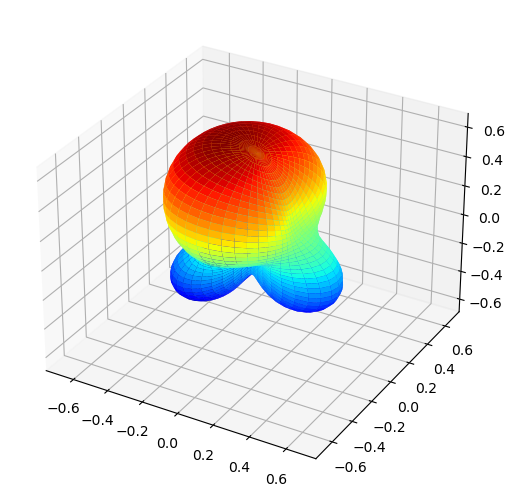

In [14]:
# Direct Xarray tensor multiplication - this will correctly handle dimensions if names match.
Irand = BLMallrand.rename({'BLM':'LM'}) * Isph
# ep.sphSumPlotX(Irand, facetDim = 't')   # Note this may need facetDim set explicitly here for non-1D cases
ep.sphSumPlotX(Irand)
Irand

Using default sph betas.
Sph plots: 
Plotting with facetDims=None, pType=a with backend=mpl.


<xarray.DataArray (LM: 9, Phi: 50, Theta: 50)>
array([[[ 1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j, ...,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j],
        [ 1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j, ...,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j],
        [ 1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j, ...,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j,
          1.07518166e-01+0.00000000e+00j],
        ...,
        [ 1.07518166e-01+0.00000000e+00j,
...
          0.00000000e+00+0.00000000e+00j],
        ...,
        [ 0.00000000e+00+0.00000000e+00j,
          3.03922200e-04-1.71165794e-04j,
          1.21069841e-03-6.81852639e-04j, ...,
          1.21069841e-03-6.81852639e-04j,
          3.03922200e-04-1.71165794e-04j,
          0.00000000e+00+0.00000000e+00j],
        [ 0.00000000e+00+0.00000000e+00j,
          3.37399371e-04-8.84765342e-05j,
          1.34405740e-03-3.52453355e-04j, ...,
          1.34405740e-03-3.52453355e-04j,
          3.37399371e-04-8.84765342e-05j,
          0.00000000e+00+0.00000000e+00j],
        [ 0.00000000e+00+0.00000000e+00j,
          3.48807157e-04-1.70866227e-19j,
          1.38950122e-03-6.80659290e-19j, ...,
          1.38950122e-03-6.80659290e-19j,
          3.48807157e-04-1.70866227e-19j,
          0.00000000e+00+0.00000000e+00j]]])
Coordinates:
  * LM       (LM) MultiIndex
  - l        (LM) int64 0 1 1 1 2 2 2 2 2
  - m        (LM) int64 0 -1 0 1 -2 -1 0 1 2
  * Phi      (Phi) float64 0.0 0.1282 0.2565 0.3847 ... 5.899 6.027 6.155 6.283
  * Theta    (Theta) float64 0.0 0.06411 0.1282 0.1923 ... 3.013 3.077 3.142
Attributes:
    dataType:   Itp
    long_name:  I(\theta,\phi)
    harmonics:  {'dtype': 'Complex harmonics', 'kind': 'complex', 'normType':...
    units:      arb
    normType:   sph

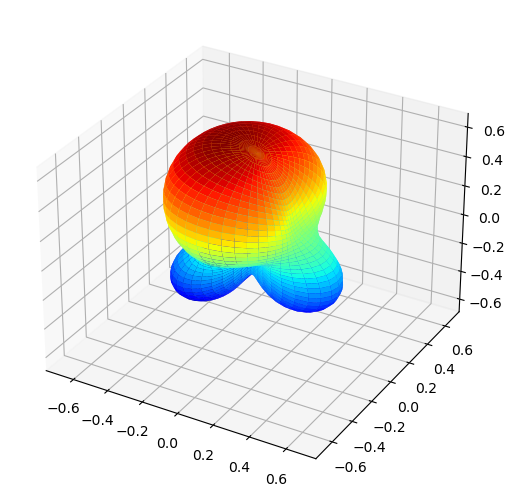

In [15]:
# Functional form - this returns array, include plotFlag = True to show plot and return a fig handle
Itp, fig = ep.sphFromBLMPlot(BLMallrand, plotFlag = True)
Itp

Using default sph betas.
Sph plots: 
Plotting with facetDims=t, pType=a with backend=pl.
*** Plotting for [1,1,0]
*** Plotting for [1,2,1]
*** Plotting for [1,3,2]
*** Plotting for [1,4,3]
*** Plotting for [1,5,4]


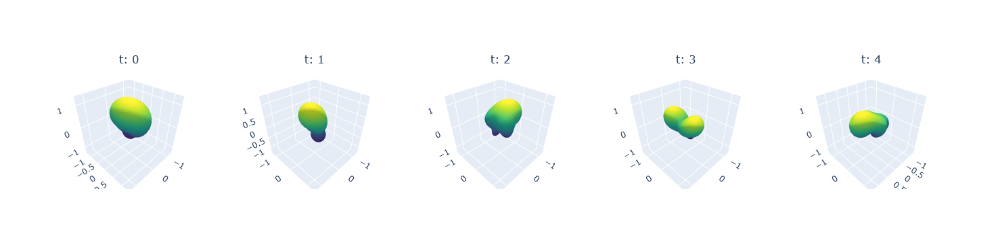

In [16]:
# Set the backend to 'pl' for an interactive surface plot with Plotly
ep.sphFromBLMPlot(BLMallrandt, facetDim = 't', plotFlag = True, backend = 'pl');

## Conversions

### Coefficient conversion

To convert $\beta_{L,M}$ normalisations and types, a few utility functions are implemented.

In [17]:
# Set some terms - note the BLM values are initially unlabelled by normType or with 'harmonics' attribututes.
LM = ep.genLM(Lmax =2, allM=False)
Blg = setBLMs(np.random.random(LM.shape[0]), LM, dtype = 'Lg', kind = 'real')  # Additional labels are set in Blg.attrs['harmonics']
#.sel(m=0, drop=False)   # Testing in XR 2022.3.0, this ALWAYS drops m for stacked dim case - should add some dim handling to conv_BL_BLM()!
Blg

<xarray.DataArray 'BLM' (BLM: 3, t: 1)>
array([[0.35304158],
       [0.89901036],
       [0.03838325]])
Coordinates:
  * BLM      (BLM) MultiIndex
  - l        (BLM) int64 0 1 2
  - m        (BLM) int64 0 0 0
  * t        (t) int64 0
Attributes:
    dataType:   BLM
    long_name:  Beta parameters
    units:      arb
    harmonics:  {'dtype': 'Lg', 'kind': 'real', 'normType': 'ortho', 'csPhase...

In [18]:
# Convert from Sph to Lg normalised values and don't renormalise
Bsp = ep.util.conversion.conv_BL_BLM(Blg, to='sph', renorm=False)
Bsp

<xarray.DataArray (BLM: 3, t: 1)>
array([[1.25149983],
       [1.83996263],
       [0.06085015]])
Coordinates:
  * BLM      (BLM) MultiIndex
  - l        (BLM) int64 0 1 2
  - m        (BLM) int64 0 0 0
  * t        (t) int64 0
Attributes:
    dataType:   BLM
    long_name:  Beta parameters
    units:      arb
    harmonics:  {'dtype': 'Lg', 'kind': 'real', 'normType': 'ortho', 'csPhase...
    normType:   sph

### SHtools conversion

To convert values to [SHtools objects](https://shtools.github.io/SHTOOLS/index.html), use `epsproc.sphFuncs.sphConv.SHcoeffsFromXR()`. Note this currently (Sept. 2022) only supports 1D input arrays.

In [19]:
BLMallrand

<xarray.DataArray 'BLM' (BLM: 9)>
array([0.38114197, 0.76058101, 0.71416467, 0.0067558 , 0.06771495,
       0.0211587 , 0.24073979, 0.88085477, 0.21997699])
Coordinates:
  * BLM      (BLM) MultiIndex
  - l        (BLM) int64 0 1 1 1 2 2 2 2 2
  - m        (BLM) int64 0 -1 0 1 -2 -1 0 1 2
Attributes:
    dataType:   BLM
    long_name:  Beta parameters
    units:      arb
    harmonics:  {'dtype': 'Complex harmonics', 'kind': 'complex', 'normType':...

In [20]:
from epsproc.sphFuncs.sphConv import *

# Create SHtools object - note some additional settings may need to be specified
sh = SHcoeffsFromXR(BLMallrand)   #, kind = 'real')
sh

kind = 'complex'
normalization = '4pi'
csphase = 1
lmax = 2
error_kind = None
header = None
header2 = None
name = None
units = None

In [21]:
# Check parameters - this are set as a 3D array, where the SHtools convention is to  index as [+/-,l,m]
sh.coeffs

array([[[0.38114197+0.j, 0.        +0.j, 0.        +0.j],
        [0.71416467+0.j, 0.0067558 +0.j, 0.        +0.j],
        [0.24073979+0.j, 0.88085477+0.j, 0.21997699+0.j]],

       [[0.        +0.j, 0.        +0.j, 0.        +0.j],
        [0.        +0.j, 0.76058101+0.j, 0.        +0.j],
        [0.        +0.j, 0.0211587 +0.j, 0.06771495+0.j]]])

In [22]:
# SHtools has various conversion routines
sh.convert(csphase =1 , normalization='ortho')

kind = 'complex'
normalization = 'ortho'
csphase = 1
lmax = 2
error_kind = None
header = None
header2 = None
name = None
units = None

(<Figure size 640x704 with 4 Axes>,
 array([<AxesSubplot:title={'center':'Real component'}, xlabel='Longitude', ylabel='Latitude'>,
        <AxesSubplot:title={'center':'Imaginary component'}, xlabel='Longitude', ylabel='Latitude'>],
       dtype=object))

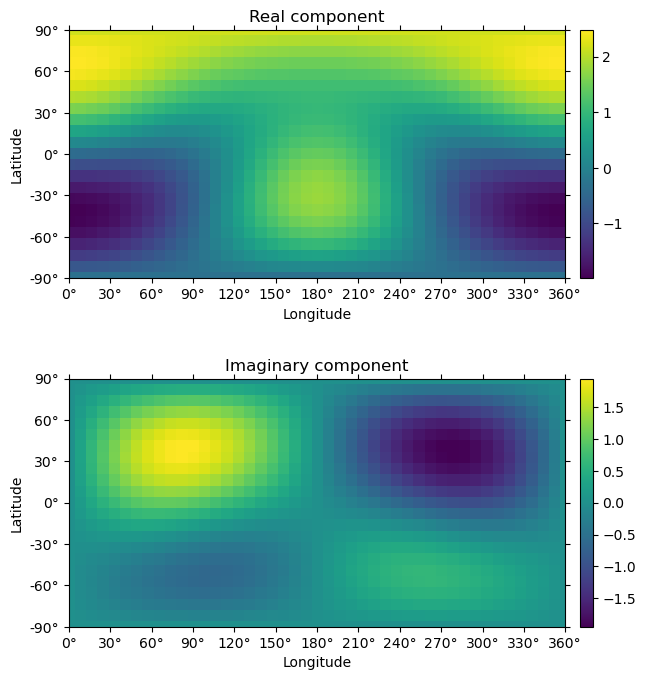

In [23]:
# SHtools expand on grid & plot
lmaxGrid = 10
grid = sh.expand(lmax = lmaxGrid)
grid.plot(colorbar='right')   

## Versions

In [24]:
import scooby
scooby.Report(additional=['epsproc', 'holoviews', 'hvplot', 'xarray', 'matplotlib', 'bokeh'])

--------------------------------------------------------------------------------
  Date: Wed Sep 21 18:51:23 2022 UTC

                OS : Linux
            CPU(s) : 32
           Machine : x86_64
      Architecture : 64bit
               RAM : 50.1 GiB
       Environment : Jupyter

  Python 3.9.10 | packaged by conda-forge | (main, Feb  1 2022, 21:24:11)
  [GCC 9.4.0]

           epsproc : 1.3.2-dev
         holoviews : 1.14.8
            hvplot : Module not found
            xarray : 2022.3.0
        matplotlib : 3.5.1
             bokeh : 2.4.2
             numpy : 1.21.5
             scipy : 1.8.0
           IPython : 8.1.1
            scooby : 0.5.12
--------------------------------------------------------------------------------

In [25]:
# Check current Git commit for local ePSproc version
from pathlib import Path
!git -C {Path(ep.__file__).parent} branch
!git -C {Path(ep.__file__).parent} log --format="%H" -n 1

* dev
  master
  numba-tests
3e3b4fc7d8a41757cbabd0a5ea4de6f4f71b4125


In [26]:
# Check current remote commits
!git ls-remote --heads https://github.com/phockett/ePSproc

92c661789a7d2927f2b53d7266f57de70b3834fa	refs/heads/dependabot/pip/notes/envs/envs-versioned/mistune-2.0.3
fe1e9540c7b91fe571f60562acd31d8e489d491e	refs/heads/dependabot/pip/notes/envs/envs-versioned/nbconvert-6.5.1
815a839f3c8c4995532d6b5f87997b8ba2bb12eb	refs/heads/dev
1c0b8fd409648f07c85f4f20628b5ea7627e0c4e	refs/heads/master
69cd89ce5bc0ad6d465a4bd8df6fba15d3fd1aee	refs/heads/numba-tests
ea30878c842f09d525fbf39fa269fa2302a13b57	refs/heads/revert-9-master
